# Self-Driving Car Engineer Nanodegree

## Computer Vision + Supervised Learning

## Project: Vehicle Detection and Tracking

In this notebook, a template is provided for you to implement your functionality in stages which is required to successfully complete this project. If additional code is required that cannot be included in the notebook, be sure that the Python code is successfully imported and included in your submission, if necessary. Sections that begin with **'Implementation'** in the header indicate where you should begin your implementation for your project. Note that some sections of implementation are optional, and will be marked with **'Optional'** in the header.

In addition to implementing code, there will be questions that you must answer which relate to the project and your implementation. Each section where you will answer a question is preceded by a **'Question'** header. Carefully read each question and provide thorough answers in the following text boxes that begin with **'Answer:'**. Your project submission will be evaluated based on your answers to each of the questions and the implementation you provide.

>**Note:** Code and Markdown cells can be executed using the **Shift + Enter** keyboard shortcut. In addition, Markdown cells can be edited by typically double-clicking the cell to enter edit mode.

## 0. Import Libraries

In [1]:
import pickle
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.image as pimg
import glob
import cv2
from datetime import timedelta
from time import time
from random import random
from random import sample
import os.path
%matplotlib inline

from sklearn.svm import LinearSVC
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from skimage.feature import hog
from scipy.misc import imread
from scipy.ndimage.measurements import label
from collections import deque

# Everything needed to edit/save/watch video clips
from moviepy.editor import VideoFileClip
from IPython.display import HTML


## 1. Helpers, Globals and Routines

In [2]:
########################################################
# Helper function to plot images side-by-side with title
########################################################
def plot_gallery(images, titles, h, w, n_row=5, n_col=4):
    """Helper function to plot a gallery of portraits"""
    # plt.figure(figsize=(2.0 * n_col, 2.4 * n_row))
    plt.figure(figsize=(3.0 * n_col, 3.6 * n_row))
    plt.subplots_adjust(bottom=0, left=.01, right=.99, top=.90, hspace=.25)
    llen = 16
    for i in range(min(n_row * n_col, len(images))):
        plt.subplot(n_row, n_col, i + 1)
        plt.imshow(images[i], cmap=plt.cm.gray)
        title_i = titles[i]
        if len(title_i) >= llen:
            title_i = titles[i][llen:]
        plt.title(title_i, size=8)
        plt.xticks(())
        plt.yticks(())



#  Get HOG features from ONE color channel image
#  - img: one color channel or grayscale, hog() works on 1 channel a time
def get_hog_features(img, orient, pix_per_cell, cell_per_block, vis=False, feature_vec=True):
    # Call with two outputs if vis==True
    if vis == True:
        features, hog_image = hog(img, orientations=orient,
                                  pixels_per_cell=(pix_per_cell, pix_per_cell),
                                  cells_per_block=(cell_per_block, cell_per_block),
                                  transform_sqrt=True,
                                  visualise=vis, feature_vector=feature_vec)
        return features, hog_image
    # Otherwise call with one output
    else:
        features = hog(img, orientations=orient,
                       pixels_per_cell=(pix_per_cell, pix_per_cell),
                       cells_per_block=(cell_per_block, cell_per_block),
                       transform_sqrt=True,
                       visualise=vis, feature_vector=feature_vec)
        return features


    
#  Get HOG IMAGE Visualization from an Image and one color channel
#  - img: one color image
#  - hog_channel: 0/1/2;  ALL is not yet supported
def get_hog_image(img, color_space='RGB', orient=9,
                  pix_per_cell=8, cell_per_block=2, hog_channel=0):
    #0) Apply color conversion if other than 'RGB'
    if color_space != 'RGB':
        if color_space == 'HSV':
            feature_image = cv2.cvtColor(img, cv2.COLOR_RGB2HSV)
        elif color_space == 'LUV':
            feature_image = cv2.cvtColor(img, cv2.COLOR_RGB2LUV)
        elif color_space == 'HLS':
            feature_image = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
        elif color_space == 'YUV':
            feature_image = cv2.cvtColor(img, cv2.COLOR_RGB2YUV)
        elif color_space == 'YCrCb':
            feature_image = cv2.cvtColor(img, cv2.COLOR_RGB2YCrCb)
    else:
        feature_image = np.copy(img)
        
    hog_features, hog_image = get_hog_features(feature_image[:,:,hog_channel], orient,
                                               pix_per_cell, cell_per_block, vis=True, feature_vec=False)
    #1) Return concatenated features and image
    return hog_features, hog_image



# Define a function to extract features from a single image (or window)
# If img has multiple color channels, use hog_channel to select channel
# This function is very similar to extract_features()
# just for a single image rather than list of images
# This function does NOT provide HOG visualise
def single_img_features(img, color_space='RGB', orient=9,
                        pix_per_cell=8, cell_per_block=2, hog_channel=0):
    #1) Define an empty list to receive features
    img_features = []
    #2) Apply color conversion if other than 'RGB'
    if color_space != 'RGB':
        if color_space == 'HSV':
            feature_image = cv2.cvtColor(img, cv2.COLOR_RGB2HSV)
        elif color_space == 'LUV':
            feature_image = cv2.cvtColor(img, cv2.COLOR_RGB2LUV)
        elif color_space == 'HLS':
            feature_image = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
        elif color_space == 'YUV':
            feature_image = cv2.cvtColor(img, cv2.COLOR_RGB2YUV)
        elif color_space == 'YCrCb':
            feature_image = cv2.cvtColor(img, cv2.COLOR_RGB2YCrCb)
    else:
        feature_image = np.copy(img)
    #3) Apply hog to each channel
    if hog_channel == 'ALL':
        hog_features = []
        for channel in range(feature_image.shape[2]):
            hog_features.extend(get_hog_features(feature_image[:,:,channel],
                                orient, pix_per_cell, cell_per_block,
                                vis=False, feature_vec=True))
    else:
        hog_features = get_hog_features(feature_image[:,:,hog_channel], orient,
                                        pix_per_cell, cell_per_block, vis=False, feature_vec=True)
    #8) Append features to list
    img_features.append(hog_features)

    #9) Return concatenated array of features
    return np.concatenate(img_features)
    


# Define a function to extract features from a list of image files
def extract_features(imgfiles, color_space='RGB', orient=9,
                        pix_per_cell=8, cell_per_block=2, hog_channel=0):
    # Create a list to append feature vectors to
    features = []
    # Iterate through the list of images
    for file in imgfiles:
        file_features = []
        # Read in each one by one
        #image = mpimg.imread(file) # TODO watch it!!
        image = imread(file) # use scipy.misc.imread
        # apply color conversion if other than 'RGB'
        if color_space != 'RGB':
            if color_space == 'HSV':
                feature_image = cv2.cvtColor(image, cv2.COLOR_RGB2HSV)
            elif color_space == 'LUV':
                feature_image = cv2.cvtColor(image, cv2.COLOR_RGB2LUV)
            elif color_space == 'HLS':
                feature_image = cv2.cvtColor(image, cv2.COLOR_RGB2HLS)
            elif color_space == 'YUV':
                feature_image = cv2.cvtColor(image, cv2.COLOR_RGB2YUV)
            elif color_space == 'YCrCb':
                feature_image = cv2.cvtColor(image, cv2.COLOR_RGB2YCrCb)
        else: feature_image = np.copy(image)

        # Call get_hog_features() with vis=False, feature_vec=True
        if hog_channel == 'ALL':
            hog_features = []
            for channel in range(feature_image.shape[2]):
                hog_features.append(get_hog_features(feature_image[:,:,channel],
                                    orient, pix_per_cell, cell_per_block,
                                    vis=False, feature_vec=True))
            hog_features = np.ravel(hog_features)
        else:
            hog_features = get_hog_features(feature_image[:,:,hog_channel], orient,
                        pix_per_cell, cell_per_block, vis=False, feature_vec=True)

        # Append the new feature vector to the features list
        file_features.append(hog_features)
            
        features.append(np.concatenate(file_features))
    # Return list of feature vectors
    return features
    


# Define a function that takes an image,
# start and stop positions in both x and y,
# window size (x and y dimensions),
# and overlap fraction (for both x and y)
def slide_window(img, x_start_stop=[None, None], y_start_stop=[None, None],
                    xy_window=(64, 64), xy_overlap=(0.5, 0.5)):
    # If x and/or y start/stop positions not defined, set to image size
    if x_start_stop[0] == None:
        x_start_stop[0] = 0
    if x_start_stop[1] == None:
        x_start_stop[1] = img.shape[1]
    if y_start_stop[0] == None:
        y_start_stop[0] = 0
    if y_start_stop[1] == None:
        y_start_stop[1] = img.shape[0]
    # Compute the span of the region to be searched
    xspan = x_start_stop[1] - x_start_stop[0]
    yspan = y_start_stop[1] - y_start_stop[0]
    # Compute the number of pixels per step in x/y
    nx_pix_per_step = np.int(xy_window[0]*(1 - xy_overlap[0]))
    ny_pix_per_step = np.int(xy_window[1]*(1 - xy_overlap[1]))
    # Compute the number of windows in x/y
    nx_windows = np.int((xspan - xy_window[0])/nx_pix_per_step) + 1
    ny_windows = np.int((yspan - xy_window[1])/ny_pix_per_step) + 1
    # Initialize a list to append window positions to
    window_list = []
    # Loop through finding x and y window positions
    # Note: you could vectorize this step, but in practice
    # you'll be considering windows one by one with your
    # classifier, so looping makes sense
    for ys in range(ny_windows):
        for xs in range(nx_windows):
            # Calculate window position
            startx = xs*nx_pix_per_step + x_start_stop[0]
            endx = startx + xy_window[0]
            starty = ys*ny_pix_per_step + y_start_stop[0]
            endy = starty + xy_window[1]

            # Append window position to list
            window_list.append(((startx, starty), (endx, endy)))
    # Return the list of windows
    return window_list



# Define a function to draw bounding boxes
def draw_boxes(img, bboxes, color=(0, 0, 255), thick=6):
    # Make a copy of the image
    imcopy = np.copy(img)
    # Iterate through the bounding boxes
    for bbox in bboxes:
        # Draw a rectangle given bbox coordinates
        cv2.rectangle(imcopy, bbox[0], bbox[1], color, thick)
    # Return the image copy with boxes drawn
    return imcopy



# Define a function you will pass an image
# and the list of windows to be searched (output of slide_windows())
#
# Key Inputs:
#            clf - pre-trained model / classifier 
#         scaler - the same feature scaler used in model training!
#     confidence - confidence score(sample to hyperplane distance)
#                  threshold provided to clf.decision_function().
#                  fall back clf.predict() when this is not given!
#    winfeatures - precomputed featureVectors to all search windows
#                  via onetime HOG optimization! For details check:
#                  multi_wind_features()
#    N.B. Element Order btw `windows` and `winfeatures` must match!
#
def search_window2(img, windows, clf, scaler, color_space='RGB', orient=9, pix_per_cell=8,
                   cell_per_block=2, hog_channel=0, confidence = None, winfeatures = None):
    #1) Create an empty list to receive positive detection windows
    on_windows = []
    X_features = []
    if winfeatures:
        X_features = winfeatures
    else:
        #2) Iterate over all windows in the sliding windows list
        for window in windows:
            #3) Extract the test window from original image
            timg = cv2.resize(img[window[0][1]:window[1][1], window[0][0]:window[1][0]], (64, 64))
            #4) Extract features for that window using single_img_features()
            features = single_img_features(timg, color_space=color_space, orient=orient, pix_per_cell=pix_per_cell,
                                           cell_per_block=cell_per_block, hog_channel=hog_channel)
            #5) Buildup testing X list
            X_features.append(features)
            
    #6) Scale extracted features to be fed to classifier
    test_features = scaler.transform(np.vstack(X_features).astype(np.float64))
    #7) Predict using your classifier, in batch
    ##  If confidence_score isn't provided, use predict()
    if confidence == None:
        predictions = clf.predict(test_features)
    else:
        predictions = (clf.decision_function(test_features) > confidence).astype(np.uint8)
    #8) If positive (prediction == 1) then save the window
    positives = list(predictions.nonzero()[0])
    for pos in positives:
        on_windows.append(windows[pos])
    #9) Return windows for positive detections
    return on_windows



## 2. Data Set & Exploratory Data Analysis

+ <b>_To detect vehicles in video stream, we need to build a vehicle detector or classifier using good labeled data set _</b>

In this project, we use example images coming from a combination of the GTI vehicle image database, the KITTI vision benchmark suite, and examples extracted from the project video itself.

For the project vehicles dataset, the GTI* folders contain time-series data. In the KITTI folder, you may see the same vehicle appear more than once, but typically under significantly different lighting/angle from other instances.

While it is possible to really devise a train/test split that avoids having nearly identical images in both training and test sets (from time-series data) to avoid overfit, I have left the work of extracting the time-series tracks from the GTI data and separating the images manually to future efforts.


### 2.1 Data Set

+ <b>vehicles</b>
    - Vehicles images are located under `vehicles` folder of current path. Download from [vehicles](https://s3.amazonaws.com/udacity-sdc/Vehicle_Tracking/vehicles.zip)
    - 8792 samples

+ <b>non-vehicles</b>
    - Non-vehicles images are located under folder `non-vehilces` of current path. Download from [Non-vehicles](https://s3.amazonaws.com/udacity-sdc/Vehicle_Tracking/non-vehicles.zip)
    - 8968 samples

+ <b>Extra-Mining</b>
    - It is possible to augment both positive (`vehicle`) and negative (`non-vehicle`) labels by mining extra samples that are directly cropped from project video frames, to either increase accuracy or lower false positive.
    - Initially I will not follow this path (unless explicitly stated later), consider that it is time consuming and there are other options available to control false positive.
    - During the project, prediction threshold and spatial smooth (heatmap) across multiple video frames are used to mitigate and control false positives from the classifier.

+ <b>Data Set Statistics</b>
    - are provided through following code block:
    

In [3]:
vehicle_files = glob.glob('vehicles/*/*.png')
vehicle_count = len(vehicle_files)

vimage_shapes = set([])

for vcfile in vehicle_files:
    vimage = imread(vcfile)
    vimage_shapes.add(vimage.shape)
    
print("Total Vehicles in Dataset: \t", vehicle_count)
print("# of Vehicle Image Shapes: \t", len(vimage_shapes))
print("     Vehicle Images Shape:")
for shape in vimage_shapes:
    print("\t\t\t\t", shape)

print("")

nonvec_files = glob.glob('non-vehicles/*/*.png')
nonvec_count = len(nonvec_files)

nonvec_shape = set([])

for nvfile in nonvec_files:
    nonvec = imread(nvfile)
    nonvec_shape.add(nonvec.shape)
    
print("Total Non-vehicles in Dataset: \t", nonvec_count)
print("# of Non-vehicle Image Shapes: \t", len(nonvec_shape))
print("     Non-vehicle Images Shape:")
for shape in nonvec_shape:
    print("\t\t\t\t", shape)



Total Vehicles in Dataset: 	 8792
# of Vehicle Image Shapes: 	 1
     Vehicle Images Shape:
				 (64, 64, 3)

Total Non-vehicles in Dataset: 	 8968
# of Non-vehicle Image Shapes: 	 1
     Non-vehicle Images Shape:
				 (64, 64, 3)


### 2.2 Data Set Visualization

+ <b>Here I plot 5 random samples from both `vehicles` and `non-vehicles`</b>


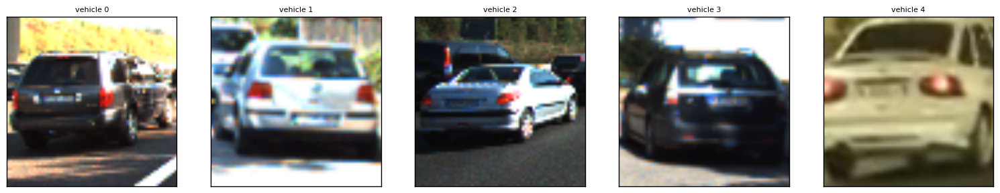

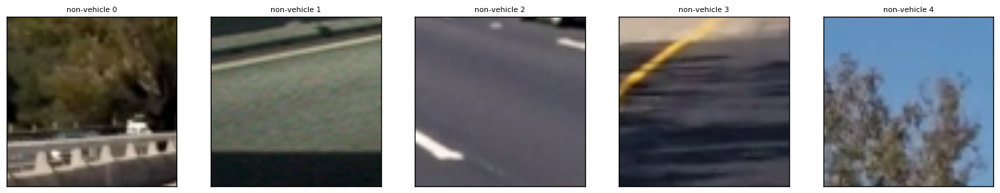

In [4]:
# random N samples to display
rN = 5
rNcars = np.zeros((rN, 64, 64, 3), np.uint8)
rNocar = np.zeros((rN, 64, 64, 3), np.uint8)
imgNames =[]

# Plot rN random vehicles from vehicle data set
for i in range(rN):
    ind = int(random()*vehicle_count)
    rNcars[i] = imread(vehicle_files[ind])
    imgNames.append('vehicle ' + str(i))
    
plot_gallery(rNcars, imgNames, 64, 64, 1, rN)

# Plot rN random non-vehicles from non-vehicle data set
imgNames = []
for i in range(rN):
    ind = int(random()*nonvec_count)
    rNocar[i] = imread(nonvec_files[ind])
    imgNames.append('non-vehicle ' + str(i))
    
plot_gallery(rNocar, imgNames, 64, 64, 1, rN)


### Above images are random samples from original dataset (no need to save to `output_images/`)

### 2.3 Data Set Summary

+ <b>Total vehicle samples: _`8792`_</b>
+ <b>Total non-vehicle samples: _`8968`_</b>
+ <b>All samples are same in shape: _`(64, 64, 3)`_</b>


## 3. Histogram of Oriented Gradients (HOG), Feature Extraction and Model

#### <b>To build reliable classifier using training data (`vehicles` and `non-vehicles`), we need to come up with good feature set to present each images:

+ Feature set should not be too big: to avoid curse of dimentionality
    - consider an image shape of (64, 64, 3), w/o feature extraction, its original feature set size = 64x64x3 = 12288, which is too big
    - Feature set too big not only causes classifier running slow, but also overfit (consider only ~9k pos/neg samples)! 
+ Feature set should also have good genericity
    - good features should not include unnecessary variance within same label space, but maximize the entropy distance between different labels


#### <b>HOG features are selected to represent each training sample, because:</b>

+ It is gradient based, it is more robust than color itself due to the nature of derivative. 
+ It is orientation based, greatly represents key features of an object, such spatial properties as skeleton


#### <b>Model Features: `HOG` features extraction in `LUV` color space:</b>

+ LUV decouple the "color" and "lightness" (luminance, the L part). This color space works well to keep invariance of changes in lighting condition.
+ Experiments (course lecture #27) demonstrate compelling empirical result using HOG features from `LUV` color space, with <b>`L`</b> channel only is enough.
+ Here intentionally <b>exclude</b> `binned color` and `color histogram` features, since:
    - `color histogram` is NOT robust considering its _LOSS_ of spatial information.
    - `binned color` is not generic enough considering a same type of vehicle may just differ in color.
    - Need to have feature set size controlled in proper range (at expense of classification):
        + E.g. To add spatial binning of 32x32 and 32 color histogram to 3 channels alone, `Feature Vector` size will _increase by 3168_
        

#### <b>HOG + LUV Parameters:</b>

+ LUV: <b>`L (1)`</b> channel
    - We will see how `L` channel is good enough from HOG visualization below
    - Using one channel HOG(-L), also helps with classifier runtime performance
    - <b>Using one channel HOG(-L), also simplified HOG arithmetic for different sliding windows optimized search as we see later</b>
+ HOG: Following (use skimage.hog()) parameters are settled via best empirical results
    - `orientations = 12`
    - `pixels_per_cell = (8, 8)`
    - `cells_per_block = (2, 2)`
+ <b>Feature Vector Size = 2352</b> = 7 x 7 x 2 x 2 x 12 (orientations) x 1 (L channel)
+ <b>Feature Vector Shape = (7, 7, 2, 2, 12)</b> or (2352,) when flattened with feature_vec=True


### 3.1 HOG Feature Extraction

#### 3.1.1 HOG Feature Visualization

+ <b>Here comes examples using `LUV` color space and above `HOG` parameters on feature visualization</b>
    - Use random vehicles (rNcars) acquired in previous step
    - Use random non-vehicles (rNocar) acquired in previous step

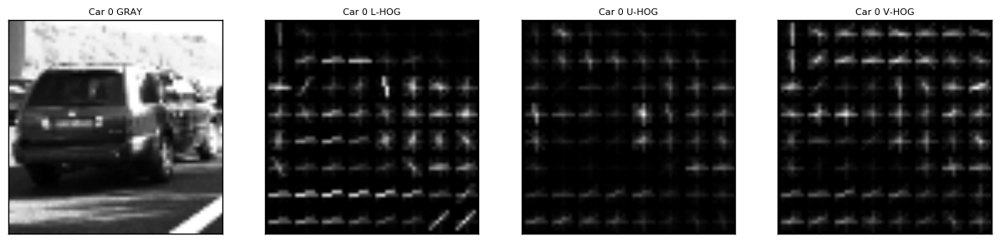

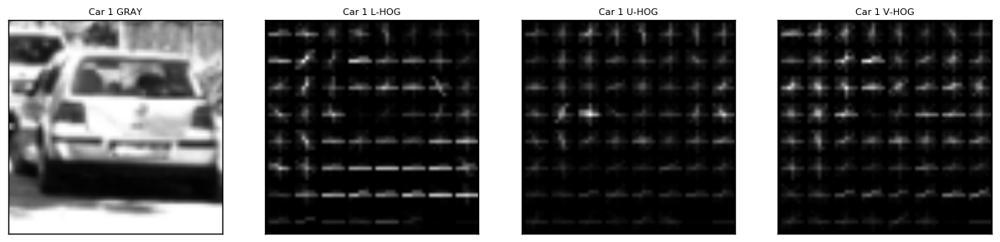

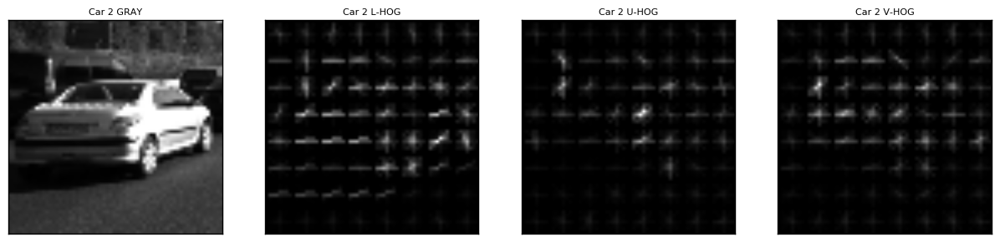

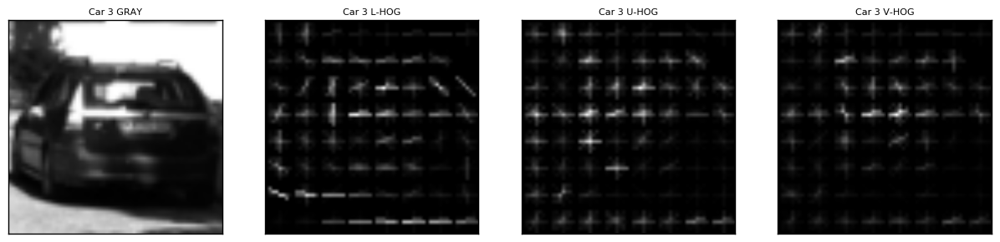

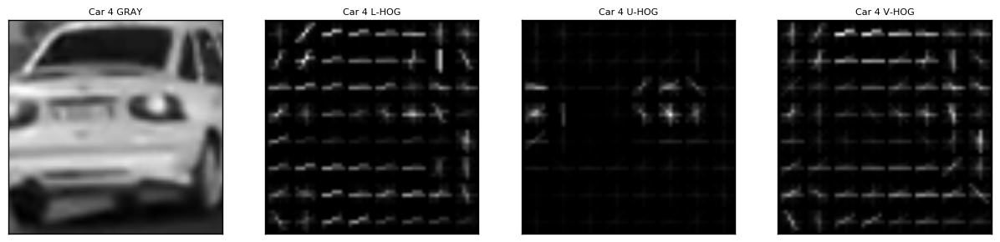

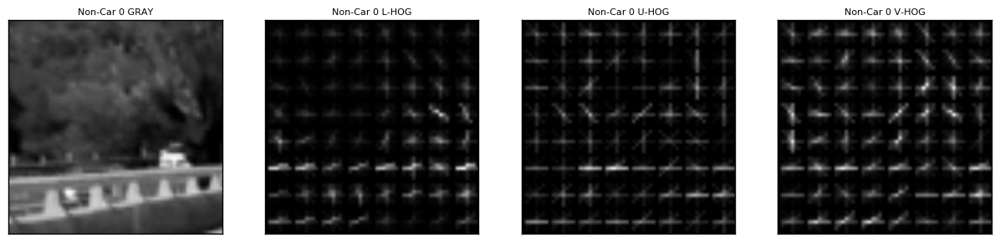

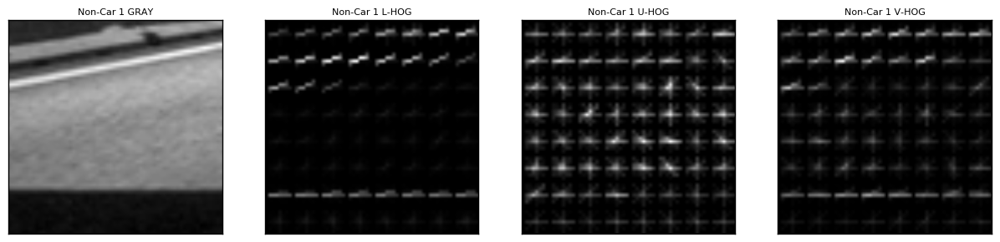

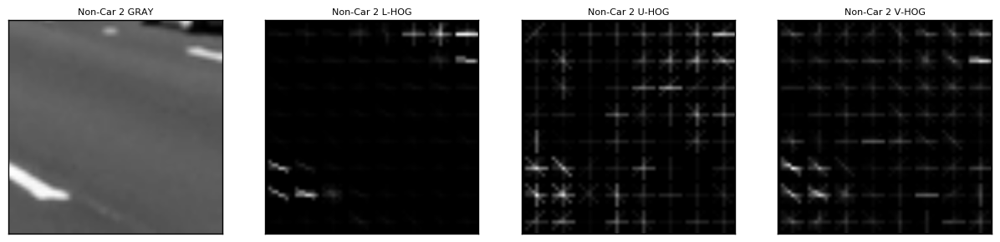

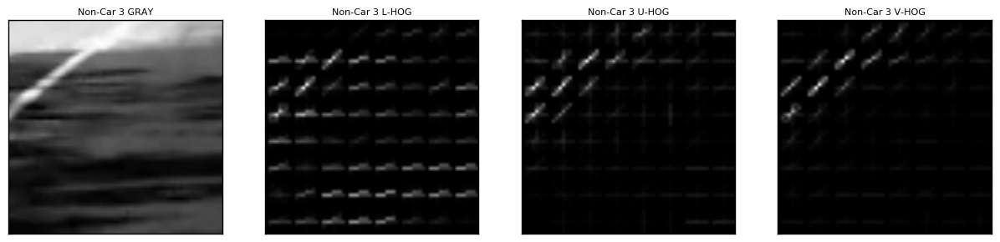

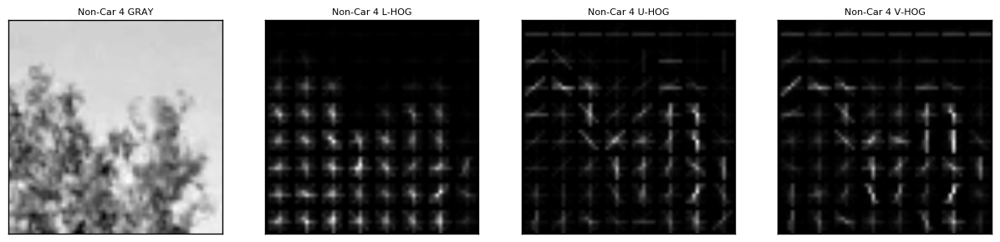

In [5]:
cH = 4
# cH:0 store original image (grayscaled, just for side-by-side visualization)
# cH:1 color channel 0, `L` of `LUV` for example
# cH:2 color channel 1, `U`
# cH:3 color channel 2, `V`

cdict = {0: 'GRAY', 1: 'L-HOG', 2: 'U-HOG', 3: 'V-HOG'}

# np array for 1 random vehicle
cars = np.zeros((cH, 64, 64))

# np array for 1 random non-vehicle
ncar = np.zeros((cH, 64, 64))

outputpath = 'output_images/'

for idx in range(len(rNcars)):
    imgNames =[]
    cars[0] = cv2.cvtColor(rNcars[idx], cv2.COLOR_RGB2GRAY)
    imgNames.append('Car ' + str(idx) + ' ' + cdict[0])

    # Build HOG image for each `LUV` channel
    for i in range(1, cH):
        imgNames.append('Car ' + str(idx) + ' ' + cdict[i])
        hog_feature, cars[i] = get_hog_image(rNcars[idx], color_space='LUV', orient=12,
                                             pix_per_cell=8, cell_per_block=2, hog_channel=i-1)
        
        outfile = outputpath + 'Car-' + str(idx) + '-' + cdict[i]
        pimg.imsave(outfile, cars[i], cmap=plt.cm.gray)
        
    # Plot a random Vehicle and HOG images side-by-side
    plot_gallery(cars, imgNames, 64, 64, 1, cH)


for idx in range(len(rNocar)):
    imgNames =[]
    ncar[0] = cv2.cvtColor(rNocar[idx], cv2.COLOR_RGB2GRAY)
    imgNames.append('Non-Car ' + str(idx) + ' ' + cdict[0])

    # Build HOG image for each `LUV` channel
    for i in range(1, cH):
        imgNames.append('Non-Car '+ str(idx) + ' ' + cdict[i])
        hog_feature, ncar[i] = get_hog_image(rNocar[idx], color_space='LUV', orient=12,
                                             pix_per_cell=8, cell_per_block=2, hog_channel=i-1)
        
        outfile = outputpath + 'Non-Car-' + str(idx) + '-' + cdict[i]
        pimg.imsave(outfile, ncar[i], cmap=plt.cm.gray)

    # Plot a random Vehicle and HOG images side-by-side
    plot_gallery(ncar, imgNames, 64, 64, 1, cH)



### Above example L/U/V-HOG images are also saved as:  `output_images/*-HOG.png`

#### N.B. Evaluate a method to produce (`one`) HOG image from 3 separate channel HOGs :  `BIN-HOG = HOG-L & HOG-U & HOG-V` in the future
+ It may help with detection rate in lowering false positive
+ It is only viable once we know how to effectively thresh HOG output on each pixel/element, data type is np.float vs. np.uint8 !!

#### As we see from `HOG` visualizations above,  `HOG-L` has been good enough to tell the difference between labels!!


### 3.2 HOG Parameters

#### 3.2.1 Final HOG Parameters

+ LUV: <b>`L (1)`</b> channel
    - We had seen how good `L` channel is from HOG visualization above
    - Using one channel HOG(-L), also helps with classifier runtime performance
    - <b>Using one channel HOG(-L), also simplified HOG arithmetic for sliding window search optimization</b>
+ HOG: Following (use skimage.hog()) parameters are settled via best empirical results
    - `orientations = 12`
    - `pixels_per_cell = (8, 8)`
    - `cells_per_block = (2, 2)`
    
#### 3.2.2 Final Feature Vector

+ <b>Feature Vector Size = 2352</b> = 7 x 7 x 2 x 2 x 12 (orientations) x 1 (L channel)
+ <b>Feature Vector Shape = (7, 7, 2, 2, 12)</b> or (2352,) when flattened with feature_vec=True


### 3.3 Model and Training

#### 3.3.1 Model/Classifier Selection

+ Multiple choices of learning models are available. Those include but not limit to:
    - Decision Tree (Forest)
    - SVM (w/ different Kernel)
    - Adaboost (Ensemble)
    - DNN/CNN
+ For the training speed, I choose following model and keep other options open to future exploration:
    - <b>LinearSVC (sklearn)</b>
+ Concerns regarding `dataset_size / feature_vector_size` ratio (called <b>`DF ratio`</b> below):
    - Small `DF ratio` is not preferred, as it is prone to overfit
    - We have ~9K data to either `vehicle` or `non-vehicle` class, total of <b>`~18K` data points</b>
    - With settled (above) <b>`Feature Vector Size: 2352`</b>, leading to a <b>`DF ratio ~= 7.6`</b> within marginal range
    - When we increase `Feature Vector Size` by introducing more features (e.g. `spatial binning` or `color histogram`), our model will be at great risk of <b>`overfit`</b> with a <b>small `DF ratio <= ~3`</b>
    - `Feature Richer` solutions (with bigger `Feature Vector`) could be built later by incorporating larger dataset!

#### 3.3.2 Model Training and Validation

+ <b>Feature Vector Size = 2352</b> = 7 x 7 x 2 x 2 x 12



In [6]:
####  These are tweaked parameters from above
#
# N.B. from previous
#      vehicle_files - 8792 image files of vehicle 
#       nonvec_files - 8968 image files of non-vehicle
#
color_space = 'LUV' # Can be RGB, HSV, LUV, HLS, YUV, YCrCb
orient = 12         # HOG orientations
pix_per_cell = 8    # HOG pixels per cell
cell_per_block = 2  # HOG cells per block
hog_channel = 0     # `L` only. Can be 0, 1, 2, or "ALL"

# Basic sanity check
assert(len(vehicle_files)==8792)
assert(len(nonvec_files)==8968)


car_features = extract_features(vehicle_files, color_space=color_space,
                        orient=orient, pix_per_cell=pix_per_cell,
                        cell_per_block=cell_per_block,hog_channel=hog_channel)

notcar_features = extract_features(nonvec_files, color_space=color_space,
                        orient=orient, pix_per_cell=pix_per_cell,
                        cell_per_block=cell_per_block, hog_channel=hog_channel)

X = np.vstack((car_features, notcar_features)).astype(np.float64)
# Fit a per-column scaler
X_scaler = StandardScaler().fit(X)
# Apply the scaler to X
scaled_X = X_scaler.transform(X)

# Define the labels vector
y = np.hstack((np.ones(len(car_features)), np.zeros(len(notcar_features))))

# Split up data into randomized training and test sets
# use preselect rand_state to have reproducible result
# - Preserve 20% data points as validation set
# - Since diverse of sample counts is not big across labels, using stratify (to keep sample distribution)
#   may not be very necessary, but just keep it around anyway
X_train, X_val, y_train, y_val = train_test_split(scaled_X, y, test_size=0.2, random_state=101, stratify=y)

print('Using:',orient,'orientations',pix_per_cell,'pixels per cell and', cell_per_block,'cells per block')
print('Feature vector length:', len(X_train[0]))

# Use a linear SVC
svc = LinearSVC()

# Check the training time for the SVC
t0=time()
svc.fit(X_train, y_train)
t1 = time()
print('LinearSVC: ', round(t1-t0, 2), ' Seconds to train ', len(y_train), ' data points')

t2 = time()
vscore = svc.score(X_val, y_val)
t3 = time()

# Check the validation score of the SVC
print('Validation Accuracy of SVC = ', round(vscore, 4))
print('LinearSVC: ', round(t3-t2, 2), ' Seconds to validate ', len(y_val), ' data points')



Using: 12 orientations 8 pixels per cell and 2 cells per block
Feature vector length: 2352
LinearSVC:  8.1  Seconds to train  14208  data points
Validation Accuracy of SVC =  0.951
LinearSVC:  0.01  Seconds to validate  3552  data points



#### 3.3.3 Model Store


In [7]:
# model file name in local path
modelfile = 'final_model.sav'

In [8]:
# save the trained model locally for future use

with open(modelfile, 'wb') as f:
    pickle.dump(svc, f)


In [9]:

with open(modelfile, mode='rb') as f:
    model = pickle.load(f)

t0 = time()
v_score = svc.score(X_val, y_val)
t1 = time()
print('Validation Accuracy of SVC = ', round(v_score, 4))
print('LinearSVC: ', round(t1-t0, 2), ' Seconds to validate ', len(y_val), ' data points')

Validation Accuracy of SVC =  0.951
LinearSVC:  0.01  Seconds to validate  3552  data points


#### 3.3.4 Model Test on testing images

+ <b> Previous step already showed validation test of our model</b>
+ <b> For `real` model test on new testing images, we need to implement sliding windows first</b>
    - Refer to 4.4 Window Search/Classification, for testing details, rough idea would be:
        - run hog() on each sliding window to get feature vector, resize window to 64x64x3, then run model predict 
        - ROI hog() once, then build feature vector per window matching to 64x64, according to its size & coordinates, then run model predict

## 4. Sliding Window Search

### I could think of 2 different approaches to locate and scope object in real-world 2D image with Computer Vision

+ #### 1. Viewpoint/Perspective Tranformation (+ 3D Reconstruction) => Detection => Reverse Perspective Tranform (warp back to 2D view)
    - Advantage: naturally feasible to acquire studio view (or 3D parameters, e.g. distance vector to viewpoint) of detected objects
    - Best with: studio cameras, or multiple camera views to derive hidden object spatial features (e.g. blind side view) & perspective with accuracy

+ #### 2. Detection on 2D image (without much 3D context)
    - 2.1 use exhaustive search with sliding windows of multiple sizes, with manual ROI (Region of Interest) narrowing
    - 2.2 use Sobel/Oriented gradients w/ histogram/heatmap to narrow searching area, then focus sliding window search
    - 2.3 Worthy noting that method `2.2` above can be extremely effective if its combined with perspective transform:
        + As in Project4, `birdeye` view over road removes noisy background, leads easy extraction of on-road objects 

#### Regardless whatever approaches we take, following technique are all required:

### Common Methodologies Needed:

+ #### 1. Good Model to do the classification job when normalized image (e.g. sliding window crop) is provided
    - Model was already trained in <b>section 3.</b>. It is saved and available for us for this use.
+ #### 2. Sliding Window techniques to crop out (select) classification candidates, as stated in section 2.1
    - Even though plain sliding window search looks exhaustive, we could still mitigate that with some technique:
        + Predefine ROI (Region of Interest) to search
        + Predefine set of discrete sliding window sizes to search
        + Predefine set of discrete overlapping (stride) to slide window
    

#### <b>In the following of this section, I only explore baseline technique of `Sliding Window Search` without considering different perspective views</b>


### 4.1 Sliding Windows Gauge and `ROI`


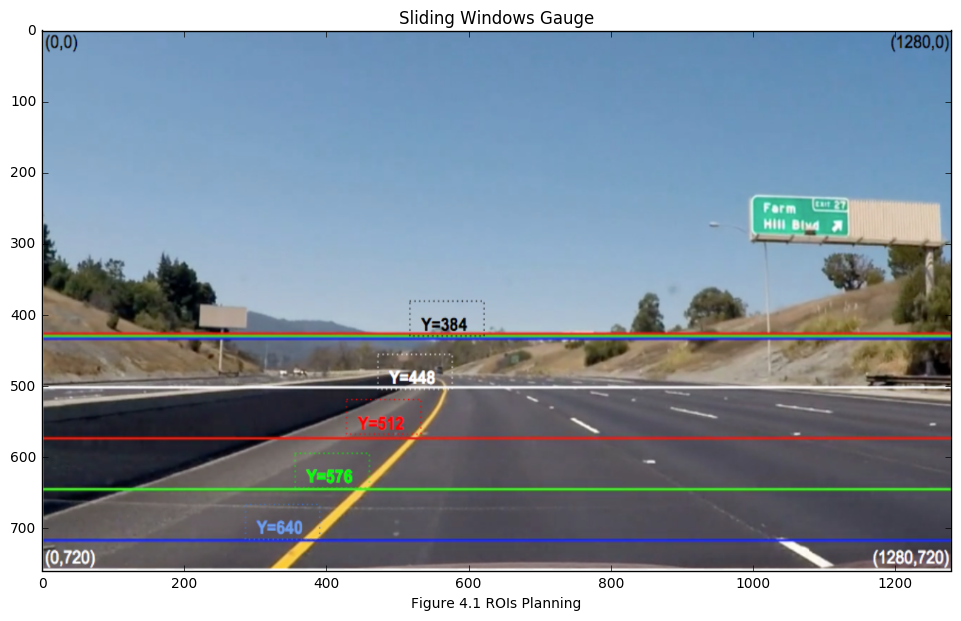

In [10]:
swin_gauge = 'output_images/SlidingWindowsGauge.png'

swing = imread(swin_gauge)
swing = cv2.resize(swing, (1280, 760))
#plt.imshow(swing)

##############################################################################
# Drew (in Left column images) Region of Selection `src` for birdeye transform
##############################################################################

f, (ax1) = plt.subplots(1, 1, figsize=(12, 6))
f.tight_layout()
ax1.imshow(swing)
ax1.set_title('Sliding Windows Gauge', fontsize=12)
ax1.set_xlabel("Figure 4.1 ROIs Planning")
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)


#### Above diagram demonstrates:
+ #### ROI: Rectangle between `Two Blue Lines`, -`OR`-
            Rectangle: [(X:0, Y:384), (X:1280, Y:384), (X:1280, Y:640), (X:0, Y:640)]
+ #### N.B. `The white line itself does NOT represent -OR- split a ROI! It is drawn as a reference.`
+ #### Y range (of `640-384`) is divided to 4 equal slices with `Delta_Y = 64` each, leave 4 different `ROIs` below:
    - <b>`ROI` of 64x64</b> searching windows: Rectangle between <b>`Two Red Lines`</b>, -`OR`-
             ROI_64: [(X:0, Y:384), (X:1280, Y:384), (X:1280, Y:512), (X:0, Y:512)]
    - <b>`ROI` of 128x128</b> searching windows: Rectangle between <b>`Two Red Lines`</b>, -`OR`-
             ROI_128: [(X:0, Y:384), (X:1280, Y:384), (X:1280, Y:512), (X:0, Y:512)]
    - <b>`ROI` of 192x192</b> searching windows: Rectangle between <b>`Two Green Lines`</b>, -`OR`-
             ROI_192: [(X:0, Y:384), (X:1280, Y:384), (X:1280, Y:576), (X:0, Y:576)]
    - <b>`ROI` of 256x256</b> searching windows: Rectangle between <b>`Two Blue Lines`</b>, -`OR`-
             ROI_256: [(X:0, Y:384), (X:1280, Y:384), (X:1280, Y:640), (X:0, Y:640)]

#### These `Four ROIs` selection to `Four different Sliding Windows` is gauged throughout `project video`, to the best outcome.


### 4.2 Sliding Window `ROIs` Demonstration

#### 6 example images below demonstrate good rationale in our choice of `4 ROIs` to `Sliding Windows of 4 sizes (64/128/196/256)` 

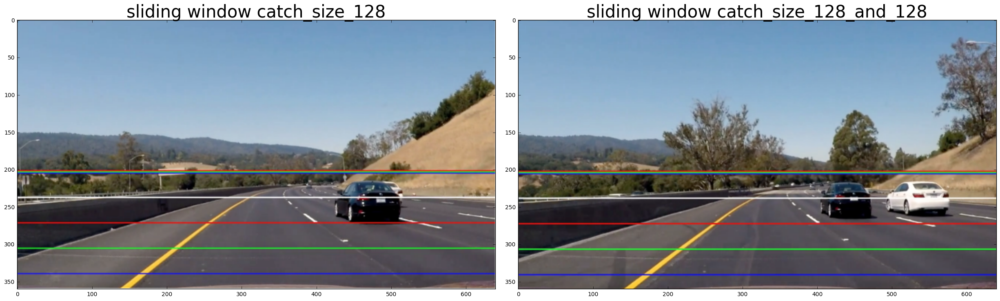

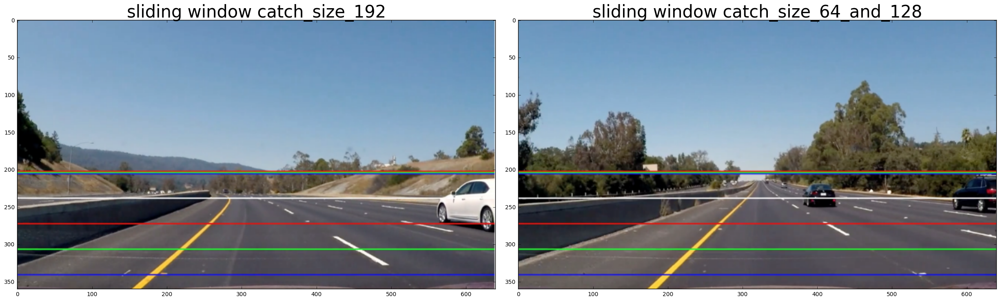

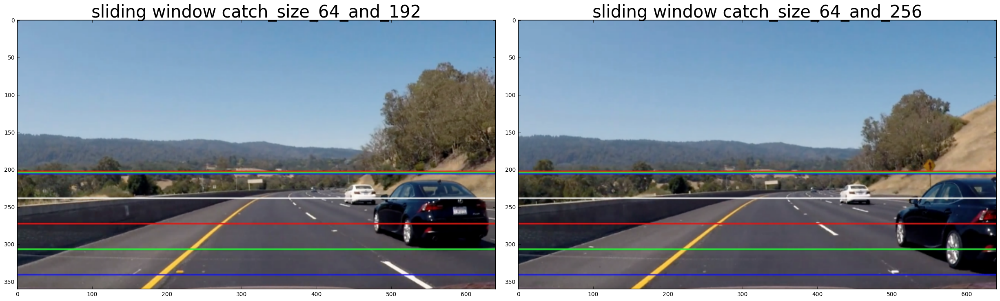

In [11]:
swin_catches = glob.glob('output_images/swin_catch*.png')

# np array for loading 6 example images
swin6s = np.zeros((6, 360, 640, 4))
# title list of example images
swin6t = []

for idx, swin in enumerate(swin_catches):
    wimage = plt.imread(swin)
    wimage = cv2.resize(wimage, (640, 360))
    swin6s[idx] = wimage
    swin6t.append(swin.split('.')[0])

##############################################################################
#        Plot catches within each ROI of each sizeof sliding windows         #
##############################################################################
for i in [0, 2, 4]:
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(swin6s[i+0])
    ax1.set_title('sliding window ' + swin6t[i+0][19:], fontsize=30)
    ax2.imshow(swin6s[i+1])
    ax2.set_title('sliding window ' + swin6t[i+1][19:], fontsize=30)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

+ #### `N.B. Need to fine adjust x_start=128 for ROI_192 to keep its x_span (width) an integer number of 192 pixels` 


### 4.3 Sliding Windows Demonstration (`Prior Search - some random sliding windows show on each ROI`) 

#### 4.3.1 Sliding Window Selections from `4 corresponding ROIs` 

In [12]:
testimage = 'test_images/test1.jpg'

image = imread(testimage)


# ROI_64:
#  64x64  sliding windows: xspan =  64*20
windows_64  = slide_window(image, x_start_stop=[None, None], y_start_stop=[384, 512],
                           xy_window=(64, 64), xy_overlap=(0.75, 0.75))
# ROI_128:
# 128x128 sliding windows: xspan = 128*10
windows_128 = slide_window(image, x_start_stop=[None, None], y_start_stop=[384, 512],
                           xy_window=(128, 128), xy_overlap=(0.75, 0.75))
# ROI_192:
# 192x192 sliding windows: xspan = 192*6 = 1152 = 6*(1280 - (x_start=128)) 
windows_192 = slide_window(image, x_start_stop=[128, None], y_start_stop=[384, 576],
                           xy_window=(192, 192), xy_overlap=(0.5, 0.5))
# ROI_256:
# 256x256 sliding windows: xspan = 256*5 = 1280
windows_256 = slide_window(image, x_start_stop=[None, None], y_start_stop=[384, 640],
                           xy_window=(256, 256), xy_overlap=(0.5, 0.5))

# Total Sliding Windows
windows = windows_64 + windows_128 + windows_192 + windows_256

print('win_64:', len(windows_64))
print('win_128:', len(windows_128))
print('win_192:', len(windows_192))
print('win_256:', len(windows_256))
print('windows:', len(windows))


win_64: 385
win_128: 37
win_192: 11
win_256: 9
windows: 442


#### Now we know there are `Total: 442` sliding windows according to our `ROIs` and `Sliding Windows` scheme

#### 4.3.2 Sliding Windows Random Sampling Visualization (on test image) 

True

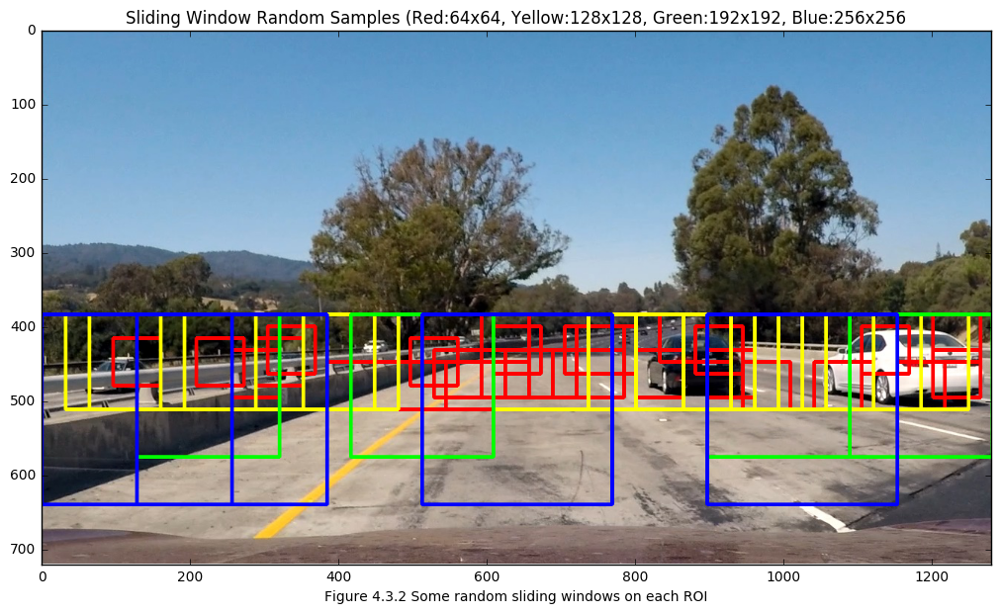

In [13]:
testimage = 'test_images/test1.jpg'

timage = imread(testimage)

# select random 32 from sliding win_64:
rs_win_64 = sample(windows_64, 32)
rswimg = draw_boxes(timage, rs_win_64, color=(255, 0, 0), thick=3)

# select random 16 from sliding win_128:
rs_win_128 = sample(windows_128, 16)
rswimg = draw_boxes(rswimg, rs_win_128, color=(255, 255, 0), thick=3)

# select random 4 from sliding win_192:
rs_win_192 = sample(windows_192, 4)
rswimg = draw_boxes(rswimg, rs_win_192, color=(0, 255, 0), thick=3)

# select random 4 from sliding win_256:
rs_win_256 = sample(windows_256, 4)
rswimg = draw_boxes(rswimg, rs_win_256, color=(0, 0, 255), thick=3)

#rs_windows = rs_win_64 + rs_win_128 + rs_win_192 + rs_win_256
#rs_win_img = draw_boxes(timage, rs_windows, color=(0, 0, 255), thick=6)                    

f, (ax1) = plt.subplots(1, 1, figsize=(12, 6))
f.tight_layout()
ax1.imshow(rswimg)
ax1.set_title('Sliding Window Random Samples (Red:64x64, Yellow:128x128, Green:192x192, Blue:256x256', fontsize=12)
ax1.set_xlabel("Figure 4.3.2 Some random sliding windows on each ROI")
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

outfile = outputpath + 'test1-random-sliding-windows.jpg'
cv2.imwrite(outfile, cv2.cvtColor(rswimg, cv2.COLOR_BGR2RGB))

### this example images is saved as:  `output_images/test1-random-sliding-windows.jpg`

### 4.4 Window Search/Classification

#### `Two primary` window classification methods (outside of a common model/classifier) exist, given a sliding window chosen.

#### 4.4.1 Non-optimal solution (window-by-window HOG extraction then classification):
+ <b>Iterate through all candidate windows (e.g. 442), do following for each:</b>
    + <b>`Resize` (to model training image size 64x64), normalize each window (data preprocessing)</b>
    + <b>`Extract HOG Feature Vector` from it, with the `same HOG parameters` used for training data</b>
    + <b>Scale window image's Feature Vector (`0 mean, unit variance`), use `same StandardScaler` from training</b>
    + <b>Send finalized Feature Vector to pre-trained Model to predict label: `vehicle` or `non-vehicle`</b>
+ <b>This method is `SLOW` due to many (442 windows) HOG calls (`1 per window`) for each test image or video frame
+ <b>But it must be reliable and act as good baseline matrix to tell `correctness / performance` of an optimization!</b>

#### Here we do this solution first:


Sliding Windows Search:  0.5  Seconds found  36  boxes


True

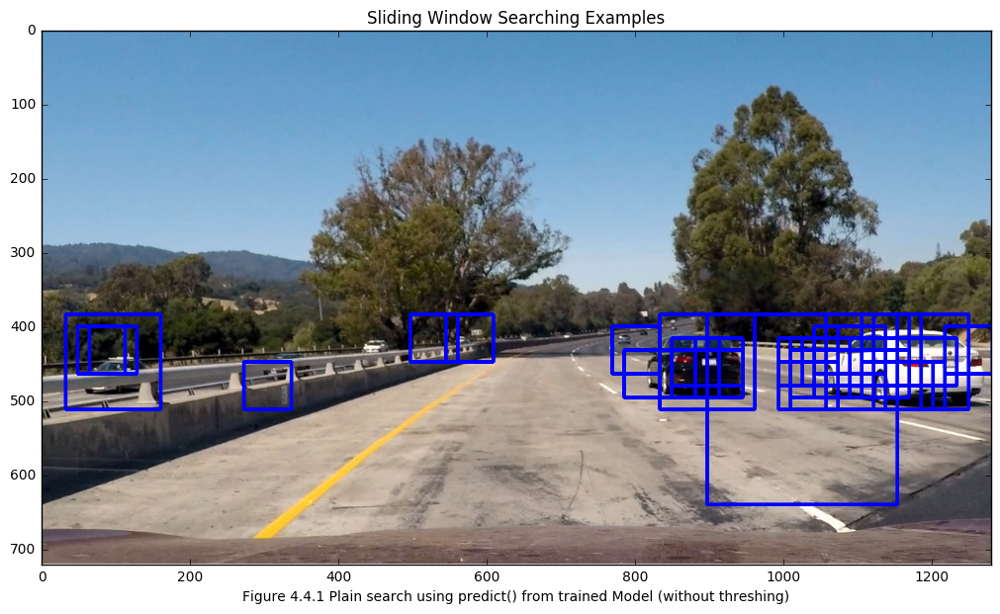

In [14]:
# This search_windows2 has implemented batch array prediction vs. for-loop sample-by-sample prediction

t0 = time()
# Search the target image in windows to detect vehicles using pre-trained SVC
hot_windows = search_window2(timage, windows, model, X_scaler, color_space='LUV',
                             orient=12, pix_per_cell=8, cell_per_block=2, hog_channel=0)
t1 = time()

print('Sliding Windows Search: ', round(t1-t0, 2), ' Seconds found ', len(hot_windows), ' boxes')

htimg = draw_boxes(timage, hot_windows, color=(0, 0, 255), thick=3)    

f, (ax1) = plt.subplots(1, 1, figsize=(12, 6))
f.tight_layout()
ax1.imshow(htimg)
ax1.set_title('Sliding Window Searching Examples', fontsize=12)
ax1.set_xlabel("Figure 4.4.1 Plain search using predict() from trained Model (without threshing)")
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

outfile = outputpath + 'sliding-window-search-predict.jpg'
cv2.imwrite(outfile, cv2.cvtColor(htimg, cv2.COLOR_BGR2RGB))

### This example image is saved as: `output_images/sliding-window-search-predict.jpg`

#### 4.4.1.1 Refine the Search (control false positive):
+ <b> As we see from single image searches above, there are bunch of false positives existing</b>
+ <b> This overfit is inevitable, mainly due to the large feature vector (high dimensionality) vs. not enough samples 
+ <b> Threshing the confidence score (svc.decision_function returns), we can greatly lower false positive, or increase precision score</b> 


Sliding Windows Search:  0.49  Seconds to find  8  boxes


True

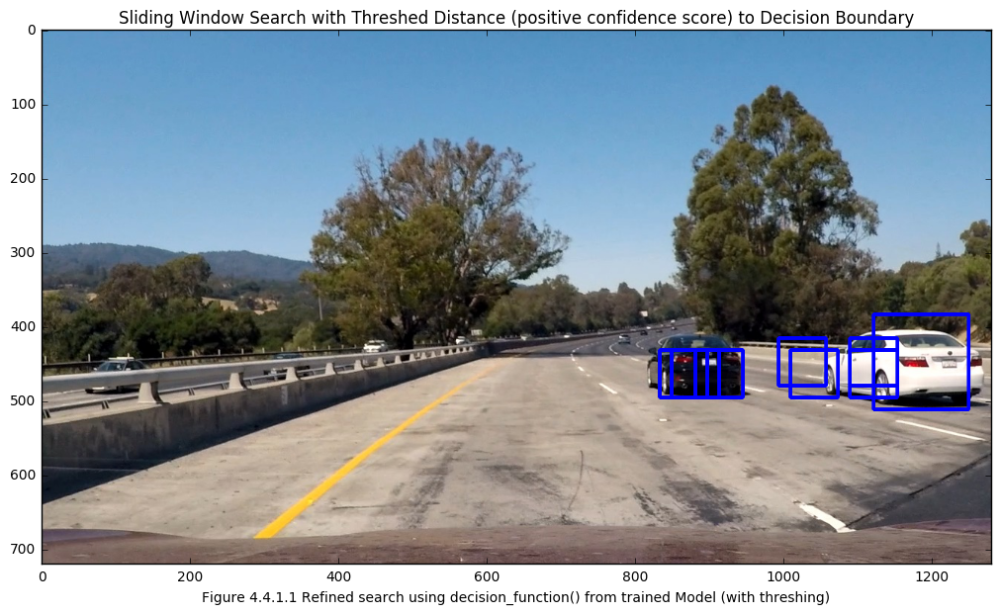

In [15]:
# 2nd version
# Notice: parameter `confidence` used in `search_window2()`

t0 = time()
# Search the target image in windows to detect vehicles using pre-trained SVC
hot_windows = search_window2(timage, windows, model, X_scaler, color_space='LUV', orient=12,
                             pix_per_cell=8, cell_per_block=2, hog_channel=0, confidence=2.1)
t1 = time()

print('Sliding Windows Search: ', round(t1-t0, 2), ' Seconds to find ', len(hot_windows), ' boxes')

htimg = draw_boxes(timage, hot_windows, color=(0, 0, 255), thick=3)    

f, (ax1) = plt.subplots(1, 1, figsize=(12, 6))
f.tight_layout()
ax1.imshow(htimg)
ax1.set_title('Sliding Window Search with Threshed Distance (positive confidence score) to Decision Boundary', fontsize=12)
ax1.set_xlabel("Figure 4.4.1.1 Refined search using decision_function() from trained Model (with threshing)")

plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

outfile = outputpath + 'sliding-window-search-decision_function.jpg'
cv2.imwrite(outfile, cv2.cvtColor(htimg, cv2.COLOR_BGR2RGB))

### This example image is saved as: `output_images/sliding-window-search-decision_function.jpg`

#### 4.4.1.2 Visualize searching results on all test images:
+ <b> Code block below produce us side-by-side view of intermediate detection results on testing images</b>

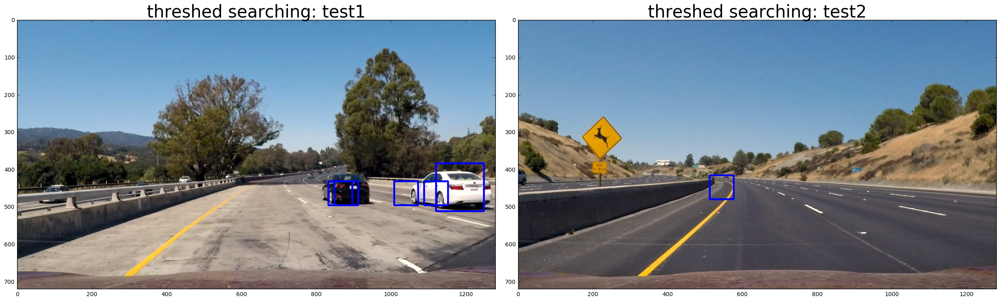

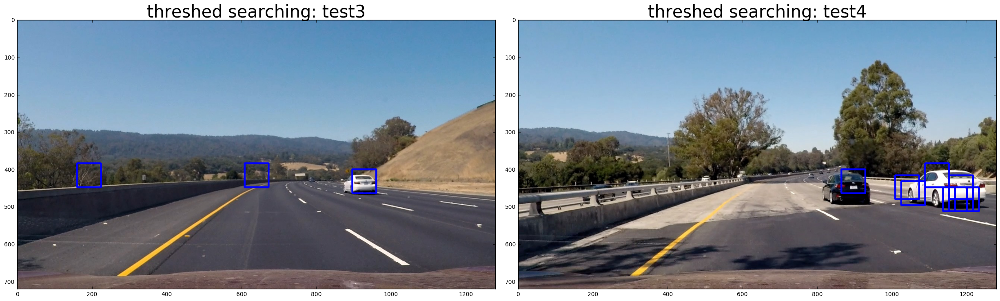

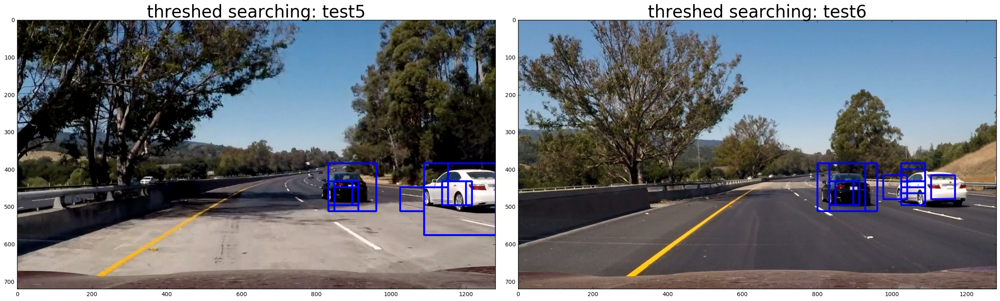

In [16]:
testImages = glob.glob('test_images/test*.jpg')

# np array for loading 6 test images
timages = np.zeros((6, 720, 1280, 3), np.uint8)
# list of titles for the test images
ttitles = []

for idx, testImage in enumerate(testImages):
    tImage = imread(testImage)
    hotwins = search_window2(tImage, windows, model, X_scaler, color_space='LUV', orient=12,
                             pix_per_cell=8, cell_per_block=2, hog_channel=0, confidence=3)
    timages[idx] = draw_boxes(tImage, hotwins, color=(0, 0, 255), thick=3)
    
    outfile = outputpath + testImage.split('/')[1].split('.')[0] + '-threshed-search.jpg'
    cv2.imwrite(outfile, cv2.cvtColor(timages[idx], cv2.COLOR_BGR2RGB))
    ttitles.append(testImage.split('.')[0])

##############################################################################
#        Plot catches within each ROI of each sizeof sliding windows         #
##############################################################################
for i in [0, 2, 4]:
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(timages[i+0])
    ax1.set_title('threshed searching: ' + ttitles[i+0][12:], fontsize=30)
    ax2.imshow(timages[i+1])
    ax2.set_title('threshed searching: ' + ttitles[i+1][12:], fontsize=30)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)


### Above example images are saved as: `output_images/test*-threshed-search.jpg`

#### According to threshed (confidence score) searching results from test images above, we know: 

+ #### Vehicles too far away (tiny in image) are unlikely detected, mainly because sliding window is NOT small enough:
    - Lower smallest sliding window size to 32x32 may help, but at cost of
        + (a) lots more windows to search and classify, so even slower
        + (b) sensitivity loss from less pixels

+ #### Occasional false positives still exist (test2/3), particularly some may come with no negligible heat density compare to true positive (test3)
    - Smooth over multiple frames to reject noise (false positive) may help

+ #### Searching performance concern
    - Figure 4.4.1 and Figure 4.4.1.1 indicate it cost ~0.5sec just to identify hot windows from 442 sliding windows
    - This may not sound a big problem to search just one image, but it does impose big penalty to video use cases:
        + (a) it costs ~15 mins to render ~1 min 30fps video clip just considering this part; it is a considerable overhead to tune project
        + (b) a practical realtime system should achieve 30fps -or- 0.03sec per frame, ~16 times faster than we have
            - Using different software infrastructure/library/OS, C/C++ or hardware may boost, but
            - <b>We are not out of option to improve performance</b>, next section <b>4.4.2</b> addresses one big performance bottleneck!



#### 4.4.2 Optimal solution (Extract HOG features just once for the entire `ROIs` in each image):
+ <b>Extract HOG features just once for the entire region of interest in each full image</b>
+ <b>Out of all 442 candidate sliding windows, optimize 385 sliding_win64 and 37 sliding_win128</b>
    + <b>This along saves 420 skimage.hog() calls per image/frame! You see soon, it is deal maker!</b>
    + <b>For each processing optimized sliding window: </b>
        - the key point is to construct its feature vector from prepared ROI HOG feature array directly vs. call hog()
        - afterwards, the classification prediction is the same
+ <b>Leave 11 sliding_win192 and 9 sliding_win256 searching are intact, i.e. non-optimal!</b>
    + the quantity is negligible
    + matrix folding is little complicated

### `multi_win_features(...)` below implements optimal feature extraction for sliding windows sizeof `64/128`

In [17]:
# Define a function to extract features from a single image (or window)
# If img has multiple color channels, use hog_channel to select channel
# This function is very similar to extract_features()
# just for a single image rather than list of images
# This function does NOT provide HOG visualise
# Only optimize for 64x64, 128x128, since they are majority
#
# returns:
#
#  features list of all 64x64 sliding windows then 128x128 sliding windows
#
def multi_wind_features(img, roix_start_stop=[None, None], roiy_start_stop=[None, None],
                        win64=None, win128=None, color_space='RGB', orient=12,
                        pix_per_cell=8, cell_per_block=2, hog_channel=0):
    if roix_start_stop[0] == None:
        roix_start_stop[0] = 0
    if roix_start_stop[1] == None:
        roix_start_stop[0] = img.shape[1]
    if roiy_start_stop[0] == None:
        roiy_start_stop[0] = 384
    if roiy_start_stop[1] == None:
        roiy_start_stop[0] = 512
    # 
    # Common ROI definition of the project:
    # roix_start_stop = [0,  1280]
    # roiy_start_stop = [384, 640]
    #
    #0) Extract ROI
    roi = img[roiy_start_stop[0]:roiy_start_stop[1], roix_start_stop[0]:roix_start_stop[1]]
    #1) Define an empty list to receive features
    roi_features = []
    #2) Apply color conversion if other than 'RGB'
    if color_space != 'RGB':
        if color_space == 'HSV':
            feature_image = cv2.cvtColor(roi, cv2.COLOR_RGB2HSV)
        elif color_space == 'LUV':
            feature_image = cv2.cvtColor(roi, cv2.COLOR_RGB2LUV)
        elif color_space == 'HLS':
            feature_image = cv2.cvtColor(roi, cv2.COLOR_RGB2HLS)
        elif color_space == 'YUV':
            feature_image = cv2.cvtColor(roi, cv2.COLOR_RGB2YUV)
        elif color_space == 'YCrCb':
            feature_image = cv2.cvtColor(roi, cv2.COLOR_RGB2YCrCb)
    else:
        feature_image = np.copy(roi)
    #3) Apply hog to each channel
    if hog_channel == 'ALL':
        # N.B. have not taken care of 'ALL' in this special optimization case
        # TODO multiple channels later!
        hog_features = []
        for channel in range(feature_image.shape[2]):
            hog_features.extend(get_hog_features(feature_image[:,:,channel],
                                orient, pix_per_cell, cell_per_block,
                                vis=False, feature_vec=False))
    else:
        hog_features64 = get_hog_features(feature_image[:,:,hog_channel], orient, 
                                          pix_per_cell, cell_per_block, vis=False, feature_vec=False)
        # Use an extra hog extraction, instead of multi-dimentional matrix shorten via hog_features64
        # This make it more convenient later when we are generating feature array for win128 windows!
        hog_features128= get_hog_features(feature_image[:,:,hog_channel], orient,
                                          pix_per_cell*2, cell_per_block, vis=False, feature_vec=False)

    #4) Append features to list
    #roi_features.append(hog_features)

    #5) Return concatenated array of features
    #return np.concatenate(roi_features)

    # With one channel: hog_features64  is now numpy.ndarray of shape (15, 159, 2, 2, 12)
    # With one channel: hog_features128 is now numpy.ndarray of shape (7,  79, 2, 2, 12)
    #
    # Following optimizations code is only built upon specific sliding windows scheme:
    #  64x64,  with stride=16, or xy_overlap=0.75, (x0%16=0) and (y0%16=0)
    # 128x128, with stride=32, or xy_overlap=0.75, (x0%32=0) and (y0%32=0)
    # 192x192, with stride=96, or xy_overlap=0.50, (x0%96=32) and (y0%96=0), N.B. ROI_192: x_start=128
    # 256x256, with stride=128,or xy_overlap=0.50, (x0%128=0) and (y0%128=0)
    #
    # Sliding Windows of 64x64 in ROI_64:
    if win64:
        features64 = []
        for win in win64:
            # then no need to do reduce matrix, just sample subarrays
            # as model training feature vector is just built on 64x64
            y0 = win[0][1]
            x0 = win[0][0]
            y1 = win[1][1]
            x1 = win[1][0]
            # Calculate sub-slice of hog feature array
            farray_ystart = int((y0 - roiy_start_stop[0])/8)
            farray_xstart = int((x0 - roix_start_stop[0])/8)
            farray = hog_features64[farray_ystart:farray_ystart+7, farray_xstart:farray_xstart+7, :, :, :]
            vector = np.ravel(farray)
            #vector=farray
            features64.append(vector)
    # Sliding Windows of 128x128 in ROI_128:
    if win128:
        features128 = []
        for win in win128:
            # also need to do reduce matrix, then sample subarrays
            # as model training feature vector is built upon 64x64
            y0 = win[0][1]
            x0 = win[0][0]
            y1 = win[1][1]
            x1 = win[1][0]
            # Calculate sub-slice of hog feature array
            farray_ystart = int((y0 - roiy_start_stop[0])/16)
            farray_xstart = int((x0 - roix_start_stop[0])/16)
            farray = hog_features128[farray_ystart:farray_ystart+7, farray_xstart:farray_xstart+7, :, :, :]
            vector = np.ravel(farray)
            #vector=farray
            features128.append(vector)
    # Combine feature lists, win64 first then win128!
    roi_features = features64 + features128
    return roi_features
            


#### 4.4.2.1 Optimal search example

Sliding Windows Fast Search:  0.02  Seconds to find  31  64/128 boxes
Sliding Windows Slow Search:  0.02  Seconds to find  0  192/256 boxes
!Performance! :)
Sliding Windows Search:  0.04  Seconds to find  31  boxes
Bleeding Fast :)


True

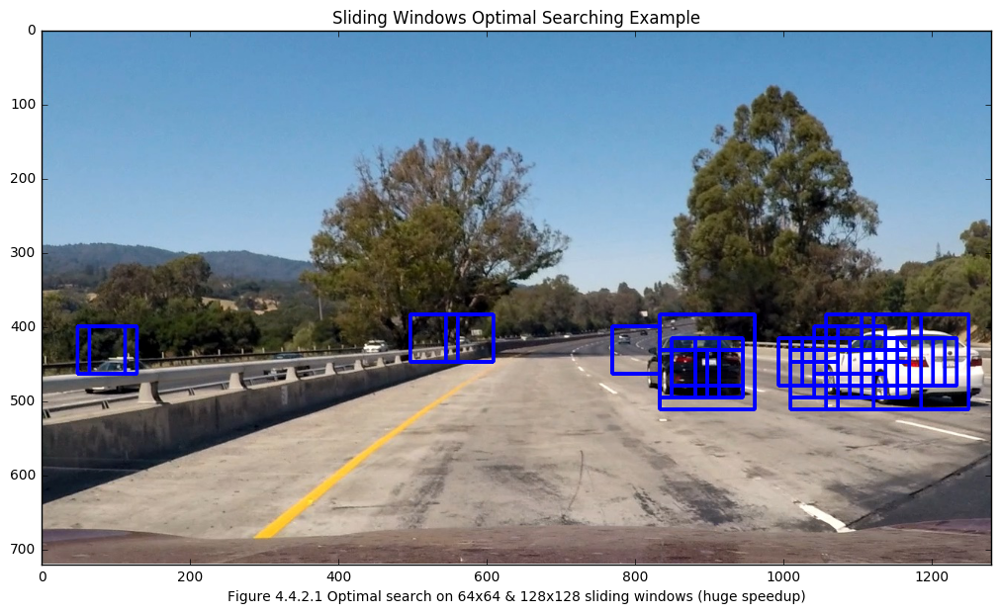

In [18]:
f64_128 = multi_wind_features(timage, roix_start_stop=[0, 1280], roiy_start_stop=[384, 512],
                              win64=windows_64, win128=windows_128, color_space='LUV', orient=12,
                              pix_per_cell=8, cell_per_block=2, hog_channel=0)
# 2nd version

win64_128  = windows_64  + windows_128
win192_256 = windows_192 + windows_256

t0 = time()
# Search the target image in windows to detect vehicles using pre-trained SVC
hot_fast = search_window2(timage, win64_128, model, X_scaler, color_space='LUV', orient=12,
                          pix_per_cell=8, cell_per_block=2, hog_channel=0, confidence=1, winfeatures=f64_128)
t1 = time()

# Search the target image in windows to detect vehicles using pre-trained SVC
hot_slow = search_window2(timage, win192_256, model, X_scaler, color_space='LUV', orient=12,
                          pix_per_cell=8, cell_per_block=2, hog_channel=0, confidence=1)
t2 = time()


print('Sliding Windows Fast Search: ', round(t1-t0, 2), ' Seconds to find ', len(hot_fast), ' 64/128 boxes')
print('Sliding Windows Slow Search: ', round(t2-t1, 2), ' Seconds to find ', len(hot_slow), ' 192/256 boxes')
print('!Performance! :)')
print('Sliding Windows Search: ', round(t2-t0, 2), ' Seconds to find ', len(hot_fast+hot_slow), ' boxes')
print('Bleeding Fast :)')

htimg = draw_boxes(timage, hot_fast + hot_slow, color=(0, 0, 255), thick=3)

f, (ax1) = plt.subplots(1, 1, figsize=(12, 6))
f.tight_layout()
ax1.imshow(htimg)
ax1.set_title('Sliding Windows Optimal Searching Example', fontsize=12)
ax1.set_xlabel("Figure 4.4.2.1 Optimal search on 64x64 & 128x128 sliding windows (huge speedup)")
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

outfile = outputpath + 'test1-optimal-search.jpg'
cv2.imwrite(outfile, cv2.cvtColor(htimg, cv2.COLOR_BGR2RGB))

### Above example image is saved as: `output_images/test1-optimal-search.jpg`
### As we see, this optimization has speed-up single image searching along by `~16 times faster`

### 5. Heatmap / Bounding Box / Fasle Positive & Noise Rejection

#### This section is to provide generic utility functions to:
+ <b>Identify high confidence detections using heatmap threshing</b>
+ <b>Draw bounding boxes around high confidence detections</b>

#### These functions can be used on single image for testing -OR- across multiple consective video frames for final smooth
+ <b>Use to single image is only for sanity testing purpose, because</b>
    - Some true positives DON'T have higher heat density than false positive in one image, so impossible to thresh
+ <b>Use across multiple images would be great to address above restrictions, and also reject noise</b>
    - There are 2 primary implementations to run smooth across multiple images, using:
        + class instances to track all detections across images, sum up each heat-count, then thresh on heat-count
        + <b>single heatmap buffer (declare in main pipeline) to sum up heatness across last K images, then thresh</b>
    - In the final video pipeline, <b>I choose to implement the 2nd method</b>, since:
        + class instance approach has further complexities, such as
            - Number of objects (of preliminary detections) varies, so a good life cycle management is preferred
            - Heuristic logic put in place to estimate each class object's moving range and identify it uniquely
        + <b>It is straightward to incorporate `Image FIFO (collections.deque)` in video processing pipeline</b>
    

#### 5.1 heatmap and threshing

+ <b>Implement generic function to generate heatmap, provided an arbitrary list of hot windows</b>
    - Use cases:
        + (a) when list of hot windows is detected from single image, heatmap generated is for single image
        + (a) when list of hot windows is accumulated from multiple images, heatmap generated is for multiple images
+ <b>Implement generic function to binary thresh provided heatmap</b>
        


In [19]:
#   image - base image the heatmap applied
# hotwins - list of hot windows (sliding windows with positive detection)
def heatmap(image, hotwins):
    heat = np.zeros_like(image[:,:,0]).astype(np.float)
    # Iterate through list of hot windows
    for win in hotwins:
        # Add += 1 for all pixels inside each bbox
        heat[win[0][1]:win[1][1], win[0][0]:win[1][0]] += 1
    # Return updated heatmap
    return heat

def heathresh(heatmap, threshold):
    # Zero out pixels below the threshold
    heatmap[heatmap <= threshold] = 0
    # Return thresholded map
    return heatmap

#### 5.1.1 Testing heatmap and threshing

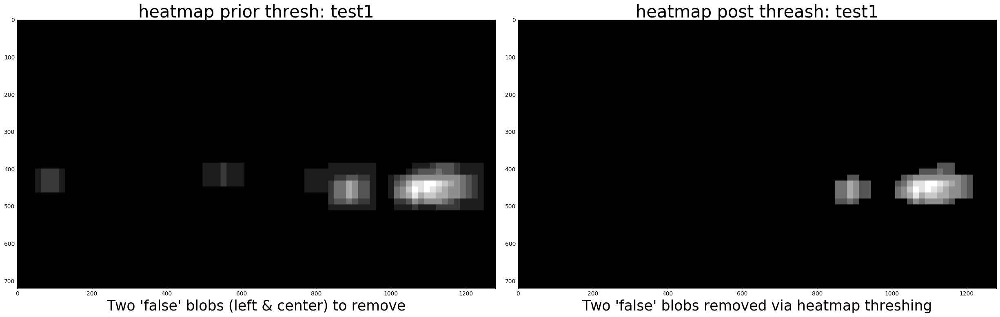

In [20]:
heat_map = heatmap(timage, hot_fast+hot_slow)
tothresh = np.copy(heat_map)
htthresh = heathresh(tothresh, 2)

f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(heat_map, cmap='gray')
ax1.set_title('heatmap prior thresh: ' + 'test1', fontsize=30)
ax1.set_xlabel("Two 'false' blobs (left & center) to remove", fontsize=25)
ax2.imshow(htthresh, cmap='gray')
ax2.set_title('heatmap post threash: ' + 'test1', fontsize=30)
ax2.set_xlabel("Two 'false' blobs removed via heatmap threshing", fontsize=25)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)


outfile = outputpath + 'test1-heatmap-prior-thresh.jpg'
pimg.imsave(outfile, heat_map, cmap=plt.cm.gray)

outfile = outputpath + 'test1-heatmap-post-thresh.jpg'
pimg.imsave(outfile, htthresh, cmap=plt.cm.gray)


### Above example images are saved as: `output_images/test1-heatmap-*-thresh.jpg`

#### 5.2 bounding box

+ <b>There are many ways you could go about trying to figure out how many cars you have in each frame and which pixels belong to which cars, but one of the most straightforward solutions is to use the label() function from scipy.ndimage.measurements.</b>
+ We can also use blob detection in Sci-kit Image (Determinant of a Hessian skimage.feature.blob_doh() worked best in experiment) to identify individual blobs in the heatmap, and then use skimage.morphology.watershed() to determin the extent of each blob using. I decide to leave this to future implementation.


In [21]:
# heatmap - threshed heatmap img
# return:
#     carNum - number of objects
#     bboxes - list of box tuple to each detection
#
def bounding_boxes(heatmap):
    bboxes = []
    labels = label(heatmap)
    carNum = labels[1]
    for carId in range(1, labels[1]+1):
        # Find pixels with each car_number label value
        nonzero = (labels[0] == carId).nonzero()
        # Identify x and y values of those pixels
        nonzeroy = np.array(nonzero[0])
        nonzerox = np.array(nonzero[1])
        # Define a bounding box based on min/max x and y
        bbox = ((np.min(nonzerox), np.min(nonzeroy)), (np.max(nonzerox), np.max(nonzeroy)))
        # add the bbox to return
        bboxes.append(bbox)
    return carNum, bboxes


#### 5.2.1 Testing bounding boxes

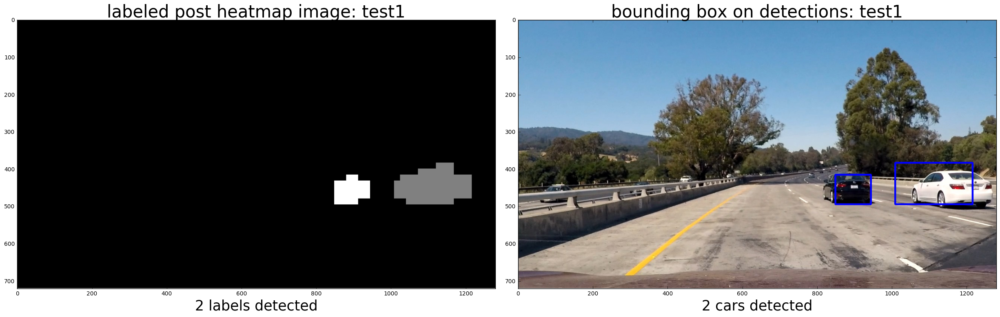

In [22]:
labels = label(htthresh)
cars, bboxes = bounding_boxes(htthresh)

for box in bboxes:
    bImage = cv2.rectangle(timage, box[0], box[1], (0,0,255), 3)

f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(labels[0], cmap='gray')
ax1.set_title('labeled post heatmap image: ' + 'test1', fontsize=30)
ax1.set_xlabel(str(cars) + " labels detected", fontsize=25)
ax2.imshow(bImage)
ax2.set_title('bounding box on detections: ' + 'test1', fontsize=30)
ax2.set_xlabel(str(cars) + " cars detected", fontsize=25)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)


outfile = outputpath + 'test1-labels.jpg'
pimg.imsave(outfile, labels[0], cmap=plt.cm.gray)

outfile = outputpath + 'test1-bboxes.jpg'
pimg.imsave(outfile, bImage, cmap=plt.cm.gray)


### Above images saved as: `output_images/test1-labels.jpg    output_images/test1-bboxes.jpg`

## 6. Project Video (Pipeline)

### 6.1 Image Pipeline

+ <b>STEPs: to each video image</b>
    - 1). Use optimized feature extraction to deploy features list of all 64x64, then 128x128 sliding windows
    - 2). Fast searching through all 64x64, then 128x128 sliding windows, using clf.decision_function() with threshold
    - 3). Normal search through all 192x192, then 256x256 sliding windows, using clf.decision_function() and threshing
    - 4). Merge all detected hot sliding windows, and calculate their aggregate heatmap
    - 5). Thresh single (current) image heatmap, as preliminary noise rejection
    - 6). Use global heatmaps deque to FIFO last K images' heatmaps, run thresh on them to smooth
    - 7). draw bounding boxes on the image to return, guard both too-tiny or too-big boxes


In [23]:
def process_image(image):
    #1)
    f64_128 = multi_wind_features(image, roix_start_stop=[0, 1280], roiy_start_stop=[384, 512],
                                  win64=windows_64, win128=windows_128, color_space='LUV', orient=12,
                                  pix_per_cell=8, cell_per_block=2, hog_channel=0)
    #2)
    hot_fast = search_window2(image, win64_128, model, X_scaler, color_space='LUV', orient=12,
                              pix_per_cell=8, cell_per_block=2, hog_channel=0, confidence=3, winfeatures=f64_128)
    #3)
    hot_slow = search_window2(image, win192_256, model, X_scaler, color_space='LUV', orient=12,
                              pix_per_cell=8, cell_per_block=2, hog_channel=0, confidence=3)
    #4)
    heat_map = heatmap(image, hot_fast+hot_slow)
    
    #5)
    htthresh = heathresh(heat_map, 1)
    #htthresh = heat_map

    #6)
    global heatmaps
    heatmaps.append(htthresh)
    hmaps = sum(heatmaps)
    hmaps = heathresh(hmaps, 15)

    #7)
    cars, bboxes = bounding_boxes(hmaps)
    for box in bboxes:
        dx = abs(box[0][0] - box[1][0])
        dy = abs(box[0][1] - box[1][1])
        mx = int((box[0][0] + box[1][0])/2)
        # remove tiny mishape boxes, from spatial split by scipy.ndimage.measurements.label()
        if dx <= 40 or dy <= 40:
            continue
        # fix-up huge mishape boxes, due to label()
        if dx >= 256:
            box = ((mx-128, box[0][1]), (mx+128, box[1][1]))
        cv2.rectangle(image, box[0], box[1], (0,0,255), 3)
    
    return image


### 6.2 Load and Process Video

In [24]:
# Play video inline
project_output = 'output_images/project5.mp4'
clip1 = VideoFileClip("project_video.mp4")
#lline = Laneline()
#rline = Laneline()
heatmaps = deque(maxlen=25)
project_clip = clip1.fl_image(process_image) #NOTE: this function expects color images!!
%time project_clip.write_videofile(project_output, audio=False)

[MoviePy] >>>> Building video output_images/project5.mp4
[MoviePy] Writing video output_images/project5.mp4


100%|█████████▉| 1260/1261 [04:03<00:00,  5.26it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: output_images/project5.mp4 

CPU times: user 14min 54s, sys: 56.8 s, total: 15min 50s
Wall time: 4min 4s


### 6.3 Play Project Video Inline

In [25]:
HTML("""
<video width="960" height="540" controls>
  <source src="{0}">
</video>
""".format(project_output))


--------

## 7. Reflection and Discussion

-    #### This model is yet very robust or generic enough given limited dataset (~9K to each of the two labels). Since model requires at least 2352 features (feature vector size), much bigger dataset is highly desired and valuable.

-    #### Yet to try high resolution feature maps, such as smaller HOG cell sizeof (4, 4) with more details. Conceptually it may help in general case, but it is considered questionable to this project, since we can't afford much bigger feature vector size with limited dataset.

-    #### color_hist and bin_spatial features are not considered generic, even though they may directly help to project (existance of some video clip vehicles in training dataset), I purposely excluded these features to avoid overfit.

-    #### In practice `ALL(3)` channel HOG features would be more robust than only the best channel (`L` in `LUV`), but I have not used `ALL` channels due to the explosion of features (2352 => 7056) from its flatten formation. I am considering matrix sum of three individual (`L/U/V`) feature matrix of shape (7, 7, 2, 2, 12) to form ONE `ALL channels` feature vector in the same sizeof(2352). But I would leave this as a next step experiement, hope it comply with HOG arithmetic.

-    #### I have implemented various performance enhancement, inluding:
        -    #### Extract HOG features of whole ROI just once for all, & align sliding windows to search!
             - <b>this along yields huge performance gain: ~20 times faster to single image searching!</b>
        -    #### Predict on an array of X_features altogether vs. sample-by-sample (see search_window2())
        -    #### Fixed buggy code of slide_window() from course lecture, yield much less sliding windows to search!
        -    #### diff slide_window slide_window_correct
                    19,20c19,20
                    <     nx_windows = np.int(xspan/nx_pix_per_step) - 1
                    <     ny_windows = np.int(yspan/ny_pix_per_step) - 1
                    ---
                    >     nx_windows = np.int((xspan - xy_window[0])/nx_pix_per_step) + 1
                    >     ny_windows = np.int((yspan - xy_window[1])/ny_pix_per_step) + 1
         

-    #### Deliberately come up with 4 ROIs using project video to gauge, to narrow the searching space:
        -    #### Searching of Area ROI_64, ROI_128 are greatly optimized
             - 64x64, 128x128 searching windows are the most majority windows to search
        -    #### Searching of Area ROI_192, ROI_256 are yet optimized
             - 192x192, 256x256 searching windows are just a few
             - Aligned matrix (global ROI HOG Feature Arrays) collapse/folding operation is little complex


-    #### Deliberately come up with 4 sizes sliding windows: 64x64, 128x128, 192x192, 256x256:
        -    #### Their space location and stepping (stride) are aligned with underlying HOG feature array.
             - <b>so no per sliding window call to skimage.feature.hog() is necessary!</b>
        -    #### Have not used 32x32 sliding window (for distant object), considering the process overhead


-    #### In this project, following mechanisms to noise and false positive rejection are implemented:
        -    #### Search ROIs are put in place, this spatial selection greatly lowers noises
        -    #### Use classifier's decision_function() to thresh positive predictions based on their confidence score
             - confidence score represent the sample distance to the classifying hyperplane (or class boundries)
             - see `confidence` parameter of function `search_window2()`
        -    #### Feature Vector tunning and selection to the best genericity:
             - `HOG-L, orient=12, pix_per_cell=8, cell_per_block=2`
        -    #### Two levels of heatmap threshing:
             - At per image level, threshold is put in place to filter a single heatmap
             - Across images level in video pipeline, FIFO of heatmaps is put in place used to filter heatmap sums
        -    #### Bounding Boxes (Detection) are only drawn from final heatmaps post all tunable filterings:
             - In addition to all above, too small or too big bounding boxes are also normalized
        -    #### Data augment or extra mining, such as `hard negative mining` is not employed:
             - It is not a generic solution, better off to increase dataset systematically

-    #### Yet to explore some other methodologies or approaches to address this project, including but not limited to:
        -    #### Deep Learning approaches to object detection, for example:
             - R-CNN (http://cs231n.stanford.edu/slides/winter1516_lecture8.pdf)
             - U-Net (Image Segmentation)
        -    #### Other supervised learner or model, such as Decision Tree, Random Forest, Adaboost, Ensemble, etc.
             - Or just different or custom SVM Kernel, e.g. RBF.
        -    #### Some other Computer Vision approach, such as DPM (Deformable Part Models)


-    #### Yet to utilize Perspective View Transformation and/or 3D reconstruction technique to estimate the spatial distance (vector) from each detected vehicle to the source camera. In real practice, this is considered an important requirement to driving safety.

     
-    #### Yet to implement further sophisticated mechanism to track each statelessly detected bounding box via scipy.ndimage.measurements.label() and threshing. Presumably better noise rejection and smoothing can be done with class based object model & object estimate heuristic.


### Thanks for your review!